## Projeto Machine Learning

### Exploratory Analysis

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

In [2]:
import os

os.getcwd()

'/content'

In [3]:
df = pd.read_csv('./train.csv')

In [4]:
df

,text_id,full_text,cohesion,syntax,vocabulary,phraseology,grammar,conventions
0,0016926B079C,I think that students would benefit from learn...,3.5,3.5,3.0,3.0,4.0,3.0
1,0022683E9EA5,When a problem is a change you have to let it ...,2.5,2.5,3.0,2.0,2.0,2.5
2,00299B378633,"Dear, Principal\n\nIf u change the school poli...",3.0,3.5,3.0,3.0,3.0,2.5
3,003885A45F42,The best time in life is when you become yours...,4.5,4.5,4.5,4.5,4.0,5.0
4,0049B1DF5CCC,Small act of kindness can impact in other peop...,2.5,3.0,3.0,3.0,2.5,2.5
...,...,...,...,...,...,...,...,...
3906,FFD29828A873,I believe using cellphones in class for educat...,2.5,3.0,3.0,3.5,2.5,2.5
3907,FFD9A83B0849,"Working alone, students do not have to argue w...",4.0,4.0,4.0,4.0,3.5,3.0
3908,FFDC4011AC9C,"""A problem is a chance for you to do your best...",2.5,3.0,3.0,3.0,3.5,3.0
3909,FFE16D704B16,Many people disagree with Albert Schweitzer's ...,4.0,4.5,4.5,4.0,4.5,4.5


Now let's see if we have null values in our dataset:

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3911 entries, 0 to 3910
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   text_id      3911 non-null   object 
 1   full_text    3911 non-null   object 
 2   cohesion     3911 non-null   float64
 3   syntax       3911 non-null   float64
 4   vocabulary   3911 non-null   float64
 5   phraseology  3911 non-null   float64
 6   grammar      3911 non-null   float64
 7   conventions  3911 non-null   float64
dtypes: float64(6), object(2)
memory usage: 244.6+ KB


Ok, everything seems fine. Let's keep going! ;)

In [6]:
np.sqrt(len(df.index))

62.53798845501828

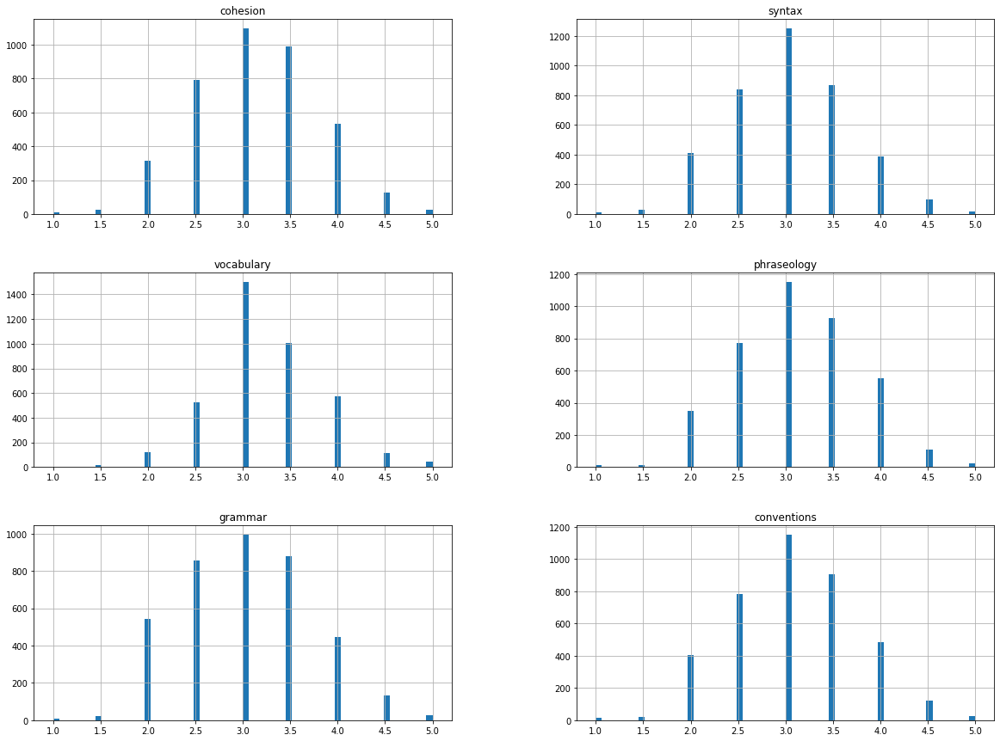

In [7]:
df.hist(bins=62, figsize=(20, 15))
plt.show()

Now let's use an tensorflow algorithm to process our data:

In [8]:
#!pip install tensorflow_text

In [9]:
import tensorflow_hub as hub
import tensorflow as tf
import tensorflow_text as text  # Registers the ops.

In [10]:
english_sentences = df['full_text']
english_sentences

0       I think that students would benefit from learn...
1       When a problem is a change you have to let it ...
2       Dear, Principal\n\nIf u change the school poli...
3       The best time in life is when you become yours...
4       Small act of kindness can impact in other peop...
                              ...                        
3906    I believe using cellphones in class for educat...
3907    Working alone, students do not have to argue w...
3908    "A problem is a chance for you to do your best...
3909    Many people disagree with Albert Schweitzer's ...
3910    Do you think that failure is the main thing fo...
Name: full_text, Length: 3911, dtype: object

In [ ]:
#3911/16

In [ ]:
#df_split  = np.array_split(english_sentences, 16)

In [ ]:
#df_split[0]

In [11]:
hub_url = "https://tfhub.dev/google/sentence-t5/st5-base/1"

encoder = hub.KerasLayer(hub_url)
tensor_list = []

nao_terminou = True

i = 0
while nao_terminou:
    tensor_list.append(encoder(english_sentences[i:i+1])[0][0])
    if i == 3910:
        nao_terminou = False
    i +=1
print(nao_terminou)


False


In [12]:
len(tensor_list)

3911

In [13]:
tensor_list = [item.numpy() for item in tensor_list]

In [14]:
tensor_list

[array([ 5.41980285e-03, -1.84182357e-02,  5.27729578e-02,  3.10256723e-02,
        -2.99954601e-03, -2.89824530e-02, -1.64460503e-02,  6.15579635e-02,
         4.15985398e-02, -7.77078839e-03,  7.72560015e-02, -5.07028289e-02,
         6.32836819e-02,  2.93884566e-03,  5.97419851e-02,  1.22559834e-02,
         2.58500781e-03,  5.44223841e-03,  3.05292234e-02,  4.83034253e-02,
         2.66755857e-02, -6.74485788e-02, -6.11729324e-02,  2.97510289e-02,
        -2.41626929e-02,  3.11046261e-02,  1.11476146e-02, -1.97184253e-02,
        -1.38886424e-03,  3.69504420e-03,  8.36449116e-02, -1.92889292e-02,
        -2.24438477e-02,  7.30532929e-02, -3.90830562e-02,  2.22816281e-02,
         1.31420521e-02, -3.30918245e-02, -3.45439911e-02,  2.74565481e-02,
         1.61687862e-02, -2.63449363e-02, -4.50581573e-02,  4.26038653e-02,
        -5.05739674e-02, -2.20145453e-02,  3.78833781e-03,  7.96086788e-02,
        -4.36994508e-02, -4.78400812e-02, -4.87190261e-02, -3.56078744e-02,
        -5.6

In [15]:
with open("tensor_values.txt", "w") as output:
    output.write(str(tensor_list))

After we generated our features, we can now use them to train our model.

In [16]:
X_train = tensor_list

Now we can use a model to test its performance in our train dataset.

In [17]:
# Split the y

df_copy = df.copy()
y_train = df_copy.drop(['full_text', 'text_id'], axis=1)
y_train

,cohesion,syntax,vocabulary,phraseology,grammar,conventions
0,3.5,3.5,3.0,3.0,4.0,3.0
1,2.5,2.5,3.0,2.0,2.0,2.5
2,3.0,3.5,3.0,3.0,3.0,2.5
3,4.5,4.5,4.5,4.5,4.0,5.0
4,2.5,3.0,3.0,3.0,2.5,2.5
...,...,...,...,...,...,...
3906,2.5,3.0,3.0,3.5,2.5,2.5
3907,4.0,4.0,4.0,4.0,3.5,3.0
3908,2.5,3.0,3.0,3.0,3.5,3.0
3909,4.0,4.5,4.5,4.0,4.5,4.5


In [18]:
%matplotlib inline
from pprint import pprint

import matplotlib.pyplot as plt
import numpy as np

from sklearn.pipeline import Pipeline
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer

In [19]:
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)

In [20]:
from sklearn.model_selection import cross_val_score


def display_scores(scores):
    print('Scores:', scores.round(decimals=2))
    print('Mean:', scores.mean())
    print('Standard deviation:', scores.std())

In [21]:
y_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3911 entries, 0 to 3910
Data columns (total 6 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   cohesion     3911 non-null   float64
 1   syntax       3911 non-null   float64
 2   vocabulary   3911 non-null   float64
 3   phraseology  3911 non-null   float64
 4   grammar      3911 non-null   float64
 5   conventions  3911 non-null   float64
dtypes: float64(6)
memory usage: 183.5 KB


In [22]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import cross_val_score

forest_clf = RandomForestRegressor(n_estimators=100, random_state=42)

In [23]:
X_train

[array([ 5.41980285e-03, -1.84182357e-02,  5.27729578e-02,  3.10256723e-02,
        -2.99954601e-03, -2.89824530e-02, -1.64460503e-02,  6.15579635e-02,
         4.15985398e-02, -7.77078839e-03,  7.72560015e-02, -5.07028289e-02,
         6.32836819e-02,  2.93884566e-03,  5.97419851e-02,  1.22559834e-02,
         2.58500781e-03,  5.44223841e-03,  3.05292234e-02,  4.83034253e-02,
         2.66755857e-02, -6.74485788e-02, -6.11729324e-02,  2.97510289e-02,
        -2.41626929e-02,  3.11046261e-02,  1.11476146e-02, -1.97184253e-02,
        -1.38886424e-03,  3.69504420e-03,  8.36449116e-02, -1.92889292e-02,
        -2.24438477e-02,  7.30532929e-02, -3.90830562e-02,  2.22816281e-02,
         1.31420521e-02, -3.30918245e-02, -3.45439911e-02,  2.74565481e-02,
         1.61687862e-02, -2.63449363e-02, -4.50581573e-02,  4.26038653e-02,
        -5.05739674e-02, -2.20145453e-02,  3.78833781e-03,  7.96086788e-02,
        -4.36994508e-02, -4.78400812e-02, -4.87190261e-02, -3.56078744e-02,
        -5.6

In [24]:
forest_clf.fit(X_train, y_train['grammar'])

RandomForestRegressor(random_state=42)

In [25]:
forest_clf.score(X_train, y_train['grammar'])

0.8826321728768053

In [26]:
# O "score" vai ser a probabilidade de que a amostra seja da classe positiva.
forest_scores = cross_val_score(
    forest_clf,
    X_train,
    y_train['grammar'],
    cv= 3,
    scoring='neg_root_mean_squared_error',
    n_jobs=-1,
)

In [27]:
forest_scores

array([-0.65040575, -0.63981345, -0.65055984])

In [28]:
display_scores(-forest_scores)

Scores: [0.65 0.64 0.65]
Mean: 0.6469263497279517
Standard deviation: 0.0050299713286160236


In [29]:
from sklearn.linear_model import LinearRegression

# define model
model = LinearRegression()
# fit model
model.fit(X_train, y_train)
# make a prediction

scores = cross_val_score(
    model,
    X_train,
    y_train,
    cv= 3,
    scoring='neg_root_mean_squared_error',
    n_jobs=-1,
)

display_scores(-scores)

Scores: [0.64 0.63 0.61]
Mean: 0.6243478383739212
Standard deviation: 0.013020612139302418


In [30]:
print(":)")

:)
